In [ ]:
!pip install ultralytics
!pip install pycocotools
!pip install supervision
!pip install segment-anything
!pip install torch torchvision
!pip install ipywidgets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 29.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 99.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 70.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 56.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 20.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 102.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling

In [ ]:
import os
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
import os
import json
import cv2
from tqdm import tqdm

DATA_DIR = "/content/drive/MyDrive/flores_anotation"
OUTPUT_JSON = os.path.join(DATA_DIR, "flores_correcto.json")

categories = []
images = []
annotations = []

category_map = {}
ann_id = 0
img_id = 0

for cat_id, class_name in enumerate(sorted(os.listdir(DATA_DIR))):
    class_path = os.path.join(DATA_DIR, class_name)
    if not os.path.isdir(class_path):
        continue

    # Registrar la categoría
    categories.append({
        "id": cat_id,
        "name": class_name,
        "supercategory": "flower"
    })
    category_map[class_name] = cat_id

    # Iterar sobre imágenes
    for fname in os.listdir(class_path):
        if fname.lower().endswith(('.jpg', '.jpeg', '.png')):
            img_path = os.path.join(class_path, fname)
            img = cv2.imread(img_path)
            if img is None:
                continue

            height, width = img.shape[:2]

            images.append({
                "id": img_id,
                "file_name": os.path.relpath(img_path, DATA_DIR),
                "height": height,
                "width": width
            })

            # Crear anotación de caja completa
            annotations.append({
                "id": ann_id,
                "image_id": img_id,
                "category_id": cat_id,
                "bbox": [0, 0, width, height],  # toda la imagen
                "area": width * height,
                "iscrowd": 0
            })

            ann_id += 1
            img_id += 1

# Construir JSON
coco_data = {
    "images": images,
    "annotations": annotations,
    "categories": categories
}

# Guardar archivo
with open(OUTPUT_JSON, 'w') as f:
    json.dump(coco_data, f, indent=2)

print(f"✅ Archivo COCO generado: {OUTPUT_JSON}")


✅ Archivo COCO generado: /content/drive/MyDrive/flores_anotation/flores_correcto.json


In [ ]:
COCO_JSON_PATH = os.path.join(DATA_DIR, "flores_anotation.json")


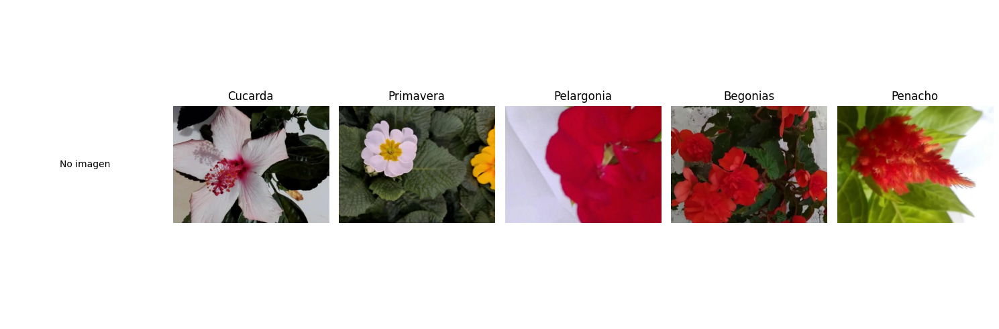

In [ ]:
import os
import matplotlib.pyplot as plt
from PIL import Image

# Ruta principal
folder_path = "/content/drive/MyDrive/flores_anotation"

# Obtener los nombres de las subcarpetas (clases)
clases = [d for d in os.listdir(folder_path) if os.path.isdir(os.path.join(folder_path, d))]

# Crear la figura con una fila y tantas columnas como clases
fig, axs = plt.subplots(1, len(clases), figsize=(15, 5))

# Si solo hay una clase, axs no será una lista, por eso
if len(clases) == 1:
    axs = [axs]

for i, clase in enumerate(clases):
    clase_path = os.path.join(folder_path, clase)
    # Buscar la primera imagen en esa clase
    imagen_encontrada = None
    for file in os.listdir(clase_path):
        if file.lower().endswith(('.png', '.jpg', '.jpeg')):
            imagen_encontrada = os.path.join(clase_path, file)
            break
    # Mostrar la imagen en la subgráfica
    if imagen_encontrada:
        img = Image.open(imagen_encontrada)
        axs[i].imshow(img)
        axs[i].axis('off')
        axs[i].set_title(clase)
    else:
        axs[i].text(0.5, 0.5, 'No imagen', ha='center', va='center')
        axs[i].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
model = YOLO("yolov8n.pt")
model.train(data="/content/drive/MyDrive/flores_anotation/yolo_dataset/dataset.yaml", epochs=50, imgsz=640, patience=10)


Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/drive/MyDrive/flores_anotation/yolo_dataset/dataset.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=10, perspective=0

train: Scanning /content/drive/MyDrive/flores_anotation/yolo_dataset/labels/train.cache... 493 images, 0 backgrounds, 0 corrupt: 100%|██████████| 493/493 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 1.6±1.3 ms, read: 17.0±18.5 MB/s, size: 75.8 KB)


val: Scanning /content/drive/MyDrive/flores_anotation/yolo_dataset/labels/val.cache... 243 images, 0 backgrounds, 0 corrupt: 100%|██████████| 243/243 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      2.26G      1.139      3.159      1.493         29        640: 100%|██████████| 31/31 [00:10<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.20it/s]


                   all        243        243    0.00447       0.96      0.294      0.168

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.28G      1.125      2.248      1.463         31        640: 100%|██████████| 31/31 [00:08<00:00,  3.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.77it/s]

                   all        243        243      0.564      0.415      0.482      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.29G      1.107      2.078      1.446         34        640: 100%|██████████| 31/31 [00:08<00:00,  3.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.87it/s]

                   all        243        243      0.514      0.606      0.554      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50       2.3G       1.14       1.94      1.449         30        640: 100%|██████████| 31/31 [00:08<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.16it/s]


                   all        243        243      0.601      0.615      0.619      0.369

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.31G      1.142      1.817      1.446         33        640: 100%|██████████| 31/31 [00:08<00:00,  3.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.30it/s]

                   all        243        243      0.425      0.471      0.401      0.186



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.33G      1.144      1.763      1.453         30        640: 100%|██████████| 31/31 [00:09<00:00,  3.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        243        243      0.543       0.54      0.552      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.33G      1.109      1.619      1.402         22        640: 100%|██████████| 31/31 [00:10<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.16it/s]


                   all        243        243      0.636      0.537      0.634      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.33G      1.044      1.469      1.372         24        640: 100%|██████████| 31/31 [00:10<00:00,  2.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        243        243      0.722      0.636      0.688      0.461



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.33G      1.069      1.485      1.365         27        640: 100%|██████████| 31/31 [00:10<00:00,  2.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.83it/s]

                   all        243        243       0.74       0.76      0.814      0.526



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.33G      1.064      1.397      1.354         30        640: 100%|██████████| 31/31 [00:10<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.06it/s]

                   all        243        243      0.766      0.811      0.853      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.33G      1.023      1.361      1.345         30        640: 100%|██████████| 31/31 [00:10<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.01it/s]

                   all        243        243      0.791        0.8      0.858      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.33G      1.051      1.288      1.352         30        640: 100%|██████████| 31/31 [00:10<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        243        243      0.756      0.765       0.77      0.541



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.33G      1.013      1.286      1.331         38        640: 100%|██████████| 31/31 [00:10<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.82it/s]


                   all        243        243      0.823      0.755      0.843      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.35G      1.006      1.211      1.318         35        640: 100%|██████████| 31/31 [00:10<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.77it/s]

                   all        243        243      0.854      0.805      0.882      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.36G     0.9824      1.143      1.303         34        640: 100%|██████████| 31/31 [00:10<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]

                   all        243        243      0.853      0.759      0.858       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.38G     0.9758      1.126       1.31         28        640: 100%|██████████| 31/31 [00:10<00:00,  3.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.94it/s]

                   all        243        243      0.838       0.79      0.868      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       2.4G     0.9694      1.093      1.306         31        640: 100%|██████████| 31/31 [00:10<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.07it/s]

                   all        243        243      0.833      0.853      0.874      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.41G     0.9573     0.9973      1.274         29        640: 100%|██████████| 31/31 [00:09<00:00,  3.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.48it/s]


                   all        243        243      0.864       0.88      0.927      0.697

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.41G     0.9124     0.9758      1.248         31        640: 100%|██████████| 31/31 [00:09<00:00,  3.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.06it/s]


                   all        243        243      0.829      0.859      0.914      0.699

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.41G     0.9428      1.035      1.273         35        640: 100%|██████████| 31/31 [00:08<00:00,  3.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.88it/s]

                   all        243        243      0.804        0.9      0.922      0.704



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.41G     0.9363     0.9526      1.268         38        640: 100%|██████████| 31/31 [00:08<00:00,  3.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]

                   all        243        243      0.816      0.882      0.908      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.41G     0.9221     0.9628      1.261         30        640: 100%|██████████| 31/31 [00:08<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]

                   all        243        243      0.871      0.817      0.916      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.41G     0.9065     0.9185      1.244         33        640: 100%|██████████| 31/31 [00:09<00:00,  3.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.79it/s]

                   all        243        243      0.867      0.874      0.921      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.41G     0.9223     0.9292      1.254         34        640: 100%|██████████| 31/31 [00:09<00:00,  3.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.90it/s]


                   all        243        243      0.876      0.887      0.934      0.731

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.41G     0.8772      0.895      1.216         25        640: 100%|██████████| 31/31 [00:10<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.13it/s]


                   all        243        243       0.89        0.9      0.951       0.75

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.41G     0.9092     0.9024      1.256         22        640: 100%|██████████| 31/31 [00:10<00:00,  3.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.85it/s]

                   all        243        243      0.857      0.931      0.942      0.759



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.41G     0.8864     0.8676      1.218         29        640: 100%|██████████| 31/31 [00:10<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.11it/s]

                   all        243        243       0.89      0.871      0.945       0.76



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.41G     0.8729     0.8439      1.224         31        640: 100%|██████████| 31/31 [00:10<00:00,  2.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.85it/s]

                   all        243        243      0.924      0.906      0.957      0.771



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.41G     0.8926     0.8695      1.222         27        640: 100%|██████████| 31/31 [00:10<00:00,  3.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.15it/s]

                   all        243        243       0.93      0.863      0.947      0.756



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.41G     0.8369     0.8332      1.194         32        640: 100%|██████████| 31/31 [00:10<00:00,  3.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.04it/s]

                   all        243        243      0.909      0.918       0.96       0.77



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.41G     0.8328     0.8037      1.204         26        640: 100%|██████████| 31/31 [00:10<00:00,  3.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.91it/s]

                   all        243        243      0.916      0.928      0.972      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.41G     0.8065      0.749       1.19         34        640: 100%|██████████| 31/31 [00:10<00:00,  2.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.06it/s]

                   all        243        243      0.911      0.951       0.96      0.784



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.41G     0.8134     0.7772      1.186         36        640: 100%|██████████| 31/31 [00:10<00:00,  3.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.01it/s]

                   all        243        243      0.921      0.948      0.967      0.791



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.41G     0.8154     0.7401       1.19         35        640: 100%|██████████| 31/31 [00:09<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.54it/s]

                   all        243        243      0.924      0.951      0.966      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.41G     0.7954     0.7379      1.177         36        640: 100%|██████████| 31/31 [00:08<00:00,  3.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.11it/s]

                   all        243        243      0.952      0.926      0.973      0.804



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.41G     0.8238     0.7082       1.19         29        640: 100%|██████████| 31/31 [00:08<00:00,  3.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]

                   all        243        243      0.929      0.942      0.966      0.793



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.41G     0.7705     0.6788      1.151         32        640: 100%|██████████| 31/31 [00:08<00:00,  3.58it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.21it/s]

                   all        243        243      0.949      0.929      0.966      0.808



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.41G     0.7891     0.6845      1.164         25        640: 100%|██████████| 31/31 [00:09<00:00,  3.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.42it/s]

                   all        243        243      0.935      0.943       0.97      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.41G      0.754     0.6957      1.149         33        640: 100%|██████████| 31/31 [00:09<00:00,  3.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.80it/s]

                   all        243        243      0.957      0.931      0.975      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.41G     0.7361     0.6573      1.137         35        640: 100%|██████████| 31/31 [00:09<00:00,  3.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.05it/s]

                   all        243        243      0.952      0.926      0.971      0.826


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.41G     0.6893     0.7175      1.165         13        640: 100%|██████████| 31/31 [00:11<00:00,  2.67it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.74it/s]

                   all        243        243      0.942      0.951      0.971      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.41G     0.6375     0.6087      1.107         13        640: 100%|██████████| 31/31 [00:09<00:00,  3.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.89it/s]

                   all        243        243      0.957      0.952      0.977      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.41G     0.6507     0.5708      1.106         13        640: 100%|██████████| 31/31 [00:10<00:00,  3.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.16it/s]

                   all        243        243      0.972      0.952      0.982      0.838



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.41G     0.6317     0.5584      1.098         13        640: 100%|██████████| 31/31 [00:09<00:00,  3.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.18it/s]


                   all        243        243      0.966      0.965      0.983      0.852

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.41G     0.6129     0.5492      1.082         13        640: 100%|██████████| 31/31 [00:09<00:00,  3.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  3.10it/s]

                   all        243        243      0.948      0.968      0.981      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.41G     0.5894     0.5374      1.073         13        640: 100%|██████████| 31/31 [00:09<00:00,  3.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.98it/s]

                   all        243        243      0.963      0.966      0.983       0.85



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.41G     0.5851     0.5075      1.076         13        640: 100%|██████████| 31/31 [00:09<00:00,  3.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.92it/s]

                   all        243        243      0.968       0.97      0.983      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.41G     0.5836     0.4973       1.07         13        640: 100%|██████████| 31/31 [00:09<00:00,  3.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:02<00:00,  2.88it/s]

                   all        243        243      0.967      0.959      0.982      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.41G     0.5695     0.4905      1.055         13        640: 100%|██████████| 31/31 [00:09<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]

                   all        243        243      0.959      0.971      0.984      0.861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.41G     0.5548     0.4889      1.048         13        640: 100%|██████████| 31/31 [00:08<00:00,  3.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.84it/s]

                   all        243        243      0.964       0.97      0.984      0.864



50 epochs completed in 0.185 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 8/8 [00:04<00:00,  1.96it/s]


                   all        243        243      0.963       0.97      0.983      0.864
              Begonias         40         40      0.906      0.975      0.983      0.843
               Cucarda         49         49      0.957          1      0.995       0.93
            Pelargonia         51         51      0.979      0.935       0.96       0.83
               Penacho         51         51      0.993       0.98      0.995      0.868
             Primavera         52         52      0.978      0.962      0.984      0.849
Speed: 0.2ms preprocess, 2.8ms inference, 0.0ms loss, 4.2ms postprocess per image
Results saved to runs/detect/train2


ultralytics.utils.metrics.DetMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3, 4])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7eea923147d0>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.041041,    0.042042,    0.043043,    0.044044,    0.045045,    0.046046,    0.047047,
        

In [ ]:
results = model.val(data="/content/drive/MyDrive/flores_anotation/yolo_dataset/dataset.yaml", imgsz=640)


Ultralytics 8.3.139 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,623 parameters, 0 gradients, 8.1 GFLOPs
val: Fast image access ✅ (ping: 0.5±0.4 ms, read: 21.3±13.0 MB/s, size: 50.1 KB)


val: Scanning /content/drive/MyDrive/flores_anotation/yolo_dataset/labels/val.cache... 243 images, 0 backgrounds, 0 corrupt: 100%|██████████| 243/243 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:04<00:00,  3.52it/s]


                   all        243        243      0.963       0.97      0.983      0.863
              Begonias         40         40      0.906      0.975      0.984      0.843
               Cucarda         49         49      0.957          1      0.995      0.929
            Pelargonia         51         51      0.979      0.934       0.96      0.832
               Penacho         51         51      0.994       0.98      0.995      0.865
             Primavera         52         52      0.979      0.962      0.984      0.849
Speed: 1.7ms preprocess, 4.8ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to runs/detect/train22


In [ ]:
model.predict(source="/content/drive/MyDrive/flores_anotation/yolo_dataset/images/val", save=True, conf=0.25)



image 1/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias Tuberosas 106.jpg: 480x640 1 Begonias, 39.6ms
image 2/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias Tuberosas 110.jpg: 480x640 2 Begoniass, 6.7ms
image 3/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias Tuberosas 111.jpg: 480x640 1 Begonias, 6.7ms
image 4/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias Tuberosas 118.jpg: 480x640 1 Begonias, 10.3ms
image 5/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias Tuberosas 121.jpg: 480x640 1 Begonias, 12.1ms
image 6/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias Tuberosas 123.jpg: 480x640 1 Begonias, 6.5ms
image 7/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias Tuberosas 128.jpg: 480x640 1 Begonias, 6.5ms
image 8/243 /content/drive/MyDrive/flores_anotation/yolo_dataset/images/val/Begonias 

[ultralytics.engine.results.Results object with attributes:
 
 boxes: ultralytics.engine.results.Boxes object
 keypoints: None
 masks: None
 names: {0: 'Begonias', 1: 'Cucarda', 2: 'Pelargonia', 3: 'Penacho', 4: 'Primavera'}
 obb: None
 orig_img: array([[[186, 186, 186],
         [185, 185, 185],
         [184, 184, 184],
         ...,
         [167, 165, 165],
         [167, 165, 165],
         [167, 165, 165]],
 
        [[186, 186, 186],
         [185, 185, 185],
         [184, 184, 184],
         ...,
         [167, 165, 165],
         [167, 165, 165],
         [167, 165, 165]],
 
        [[186, 186, 186],
         [186, 186, 186],
         [184, 184, 184],
         ...,
         [167, 165, 165],
         [167, 165, 165],
         [167, 165, 165]],
 
        ...,
 
        [[174, 174, 174],
         [175, 175, 175],
         [175, 175, 175],
         ...,
         [167, 165, 165],
         [167, 165, 165],
         [168, 166, 166]],
 
        [[174, 174, 174],
         [175, 175, 1

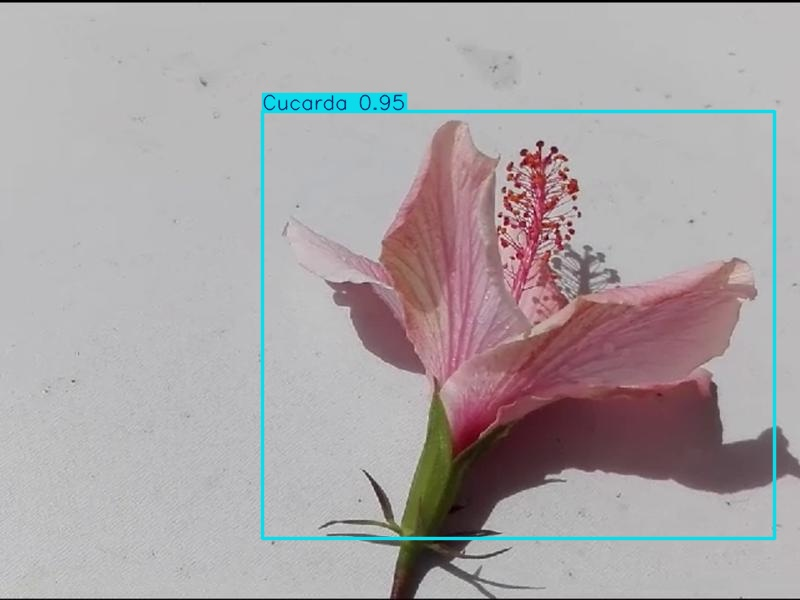

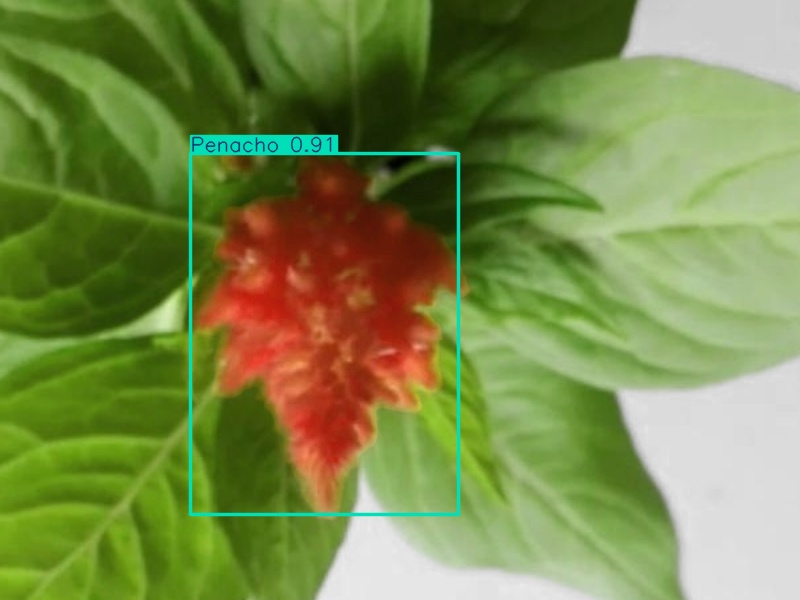

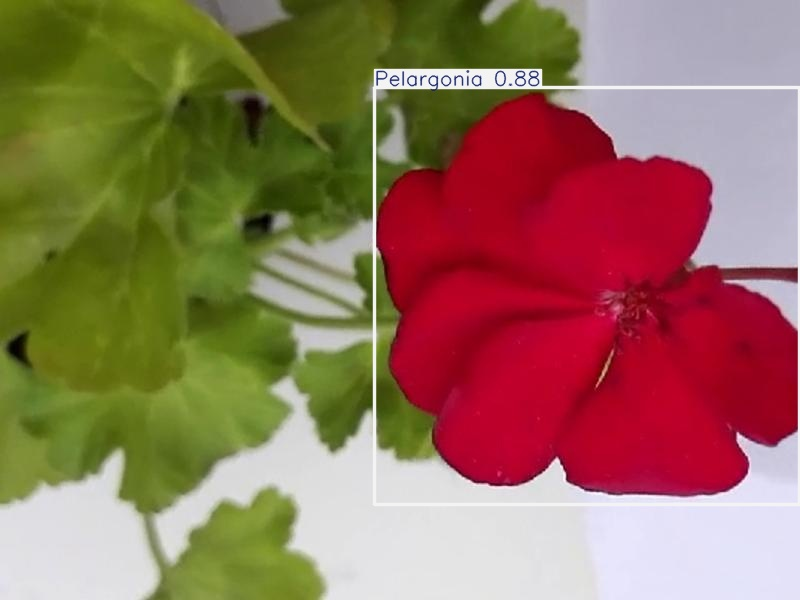

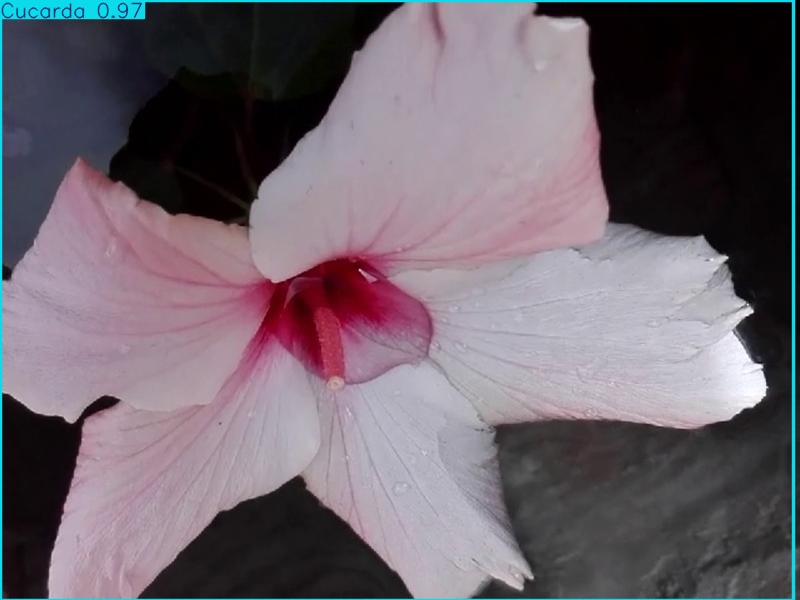

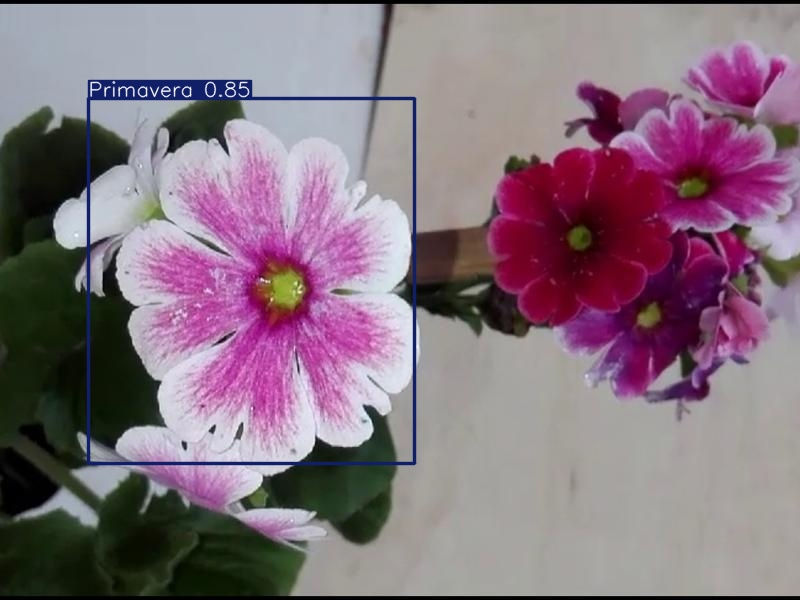

...

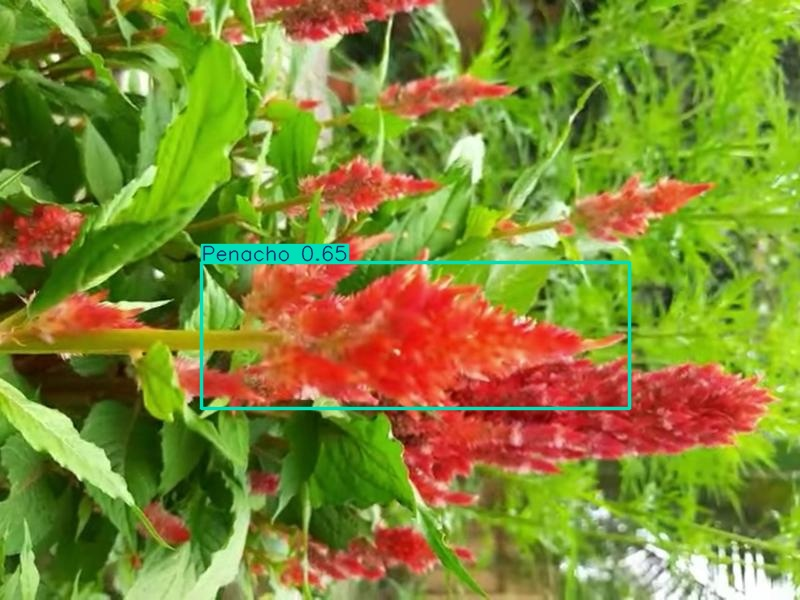

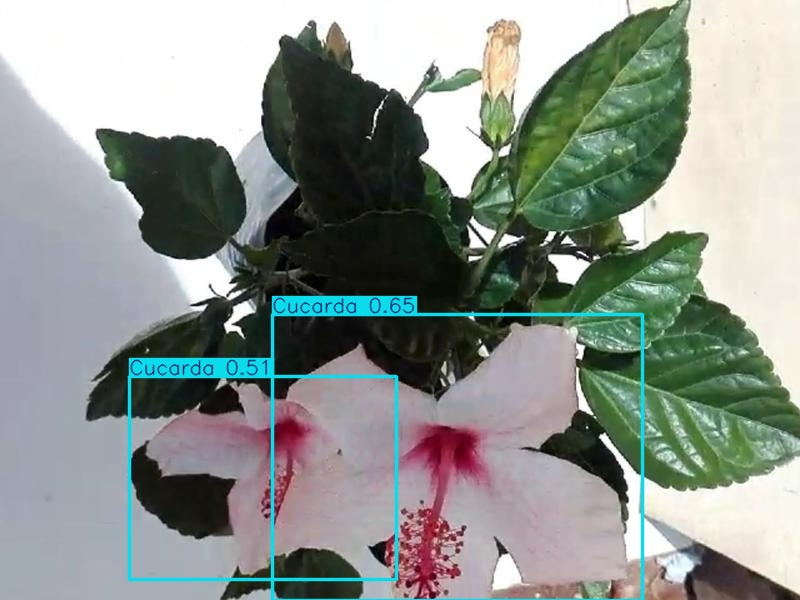

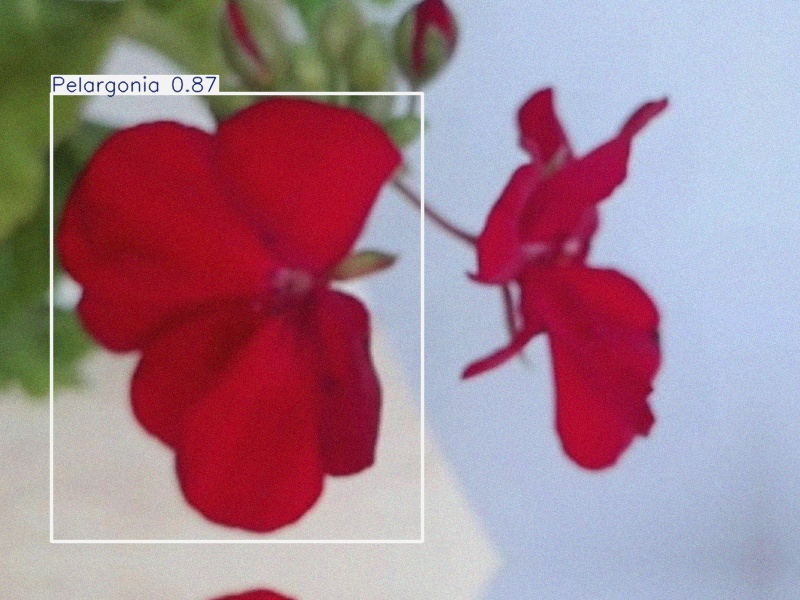

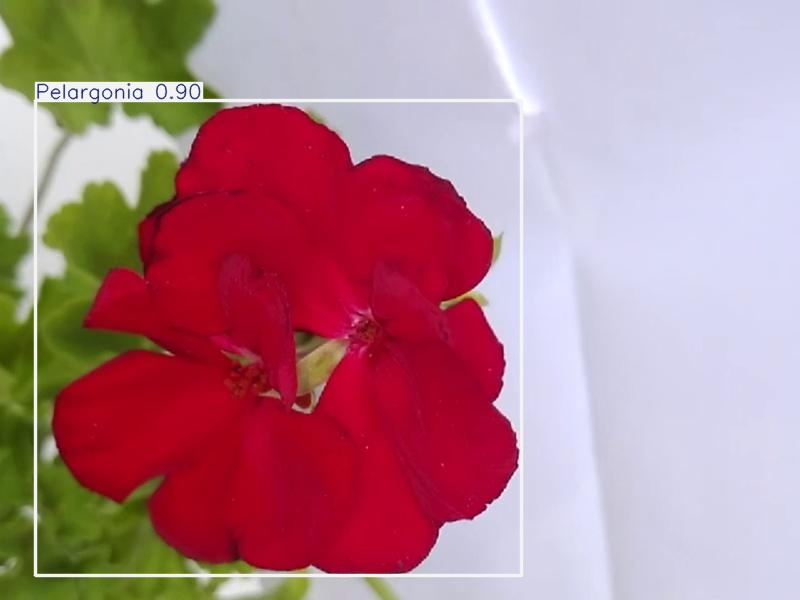

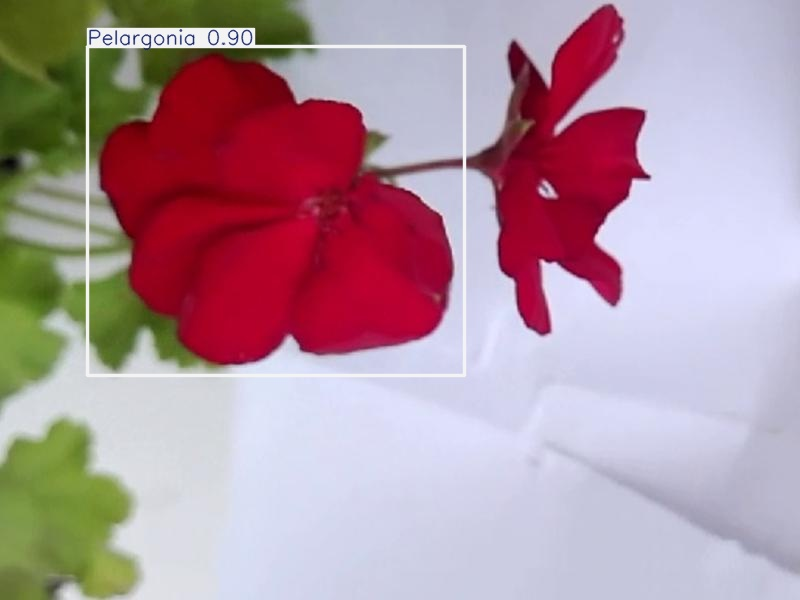

In [ ]:
import os
from IPython.display import Image, display

predict_path = "/content/runs/detect/train23"
for image_name in os.listdir(predict_path):
    display(Image(filename=os.path.join(predict_path, image_name)))
